In [1]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.layers import Input, BatchNormalization, LeakyReLU, Reshape
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Activation, Concatenate
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from tqdm.notebook import tqdm
# Бібліотека для роботи з GIF
import imageio
from IPython.display import Image
#
import matplotlib.pyplot as plt
import os
import ipywidgets

In [13]:
#!jupyter nbextension enable --py widgetsnbextension

In [3]:
DEPTH = 10
(train_images, train_labels), (_, _) = tf.keras.datasets.mnist.load_data()
train_images = train_images.reshape(train_images.shape[0], 28, 28, 1).astype('float32')
train_images = train_images / 255 # нормалізуємо в [0, 1]
train_labels = np.array(to_categorical(train_labels, DEPTH))

In [4]:
RANDOM_DIM = 100

class DataGenerator():
    def __init__(self, train_images, train_labels, batches_per_epoch, batch_size):
        self.train_images = train_images
        self.train_labels = train_labels
        self.batches_per_epoch = batches_per_epoch
        self.batch_size = batch_size
    
    @staticmethod
    def rand_norm(npoints=1, ndim=RANDOM_DIM):
        rand_vec = np.random.normal(0, 1, size=[npoints, ndim])
        # проекция на поверхю сфери
        # rand_vec = rand_vec / np.sqrt(np.sum(np.square(rand_vec), axis=1))[:, np.newaxis]
        return rand_vec

    def __len__(self):
        return self.batches_per_epoch
    
    def batch(self):
        rand_images_indexes = np.random.randint(0, train_images.shape[0], size=self.batch_size)
        image_batch = train_images[rand_images_indexes]
        labels_batch = train_labels[rand_images_indexes]
        return image_batch, labels_batch
    
    def __iter__(self):
        for b in tqdm(range(self.batches_per_epoch), leave=False):
            yield self.batch()
            
    def rand_batch(self):
        rand_vec = self.rand_norm(self.batch_size)
        rand_labels = np.random.randint(0, 10, size=[self.batch_size])
        rand_labels = np.array(to_categorical(rand_labels, DEPTH))
        return [rand_vec, rand_labels]

np.random.seed(42)
images_indexes = np.random.randint(0, len(train_images), size=16)
PICS_FROM_DATASET = [train_images[images_indexes], train_labels[images_indexes]]
FIXED_NOISE = [DataGenerator.rand_norm(16), train_labels[images_indexes]]

In [5]:
def make_generator():
    complexity = 80
    alpha = 0.2
    
    random_vector = Input(shape=[RANDOM_DIM])
    labels = Input(shape=[DEPTH])
    
    X = Concatenate()([random_vector, labels])
    # 1 шар
    X = Dense(7 * 7 * int(complexity/2),
                          input_dim=RANDOM_DIM,
                          kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02))(X)
    X = BatchNormalization()(X)
    X = LeakyReLU(alpha)(X)
    
    X = Reshape((7, 7, int(complexity/2)))(X)
    
    # 2 шар
    X = Conv2DTranspose(int(complexity), 
                        kernel_size=(5, 5),
                        strides=(2, 2),
                        padding='same')(X)
    X = BatchNormalization()(X)
    X = LeakyReLU(alpha)(X)

    # 3 шар
    X = Conv2DTranspose(int(complexity),
                        kernel_size=(5, 5),
                        strides=(1, 1),
                        padding='same')(X)
    X = BatchNormalization()(X)
    X = LeakyReLU(alpha)(X)
    
    # 4 шар
    X = Conv2DTranspose(int(complexity),
                        kernel_size=(5, 5),
                        strides=(1, 1),
                        padding='same')(X)
    X = BatchNormalization()(X)
    X = LeakyReLU(alpha)(X)
    
    # 5 шар
    X = Conv2DTranspose(int(complexity),
                        kernel_size=(5, 5),
                        strides=(1, 1),
                        padding='same')(X)
    X = BatchNormalization()(X)
    X = LeakyReLU(alpha)(X)
    
    # 6 шар
    X = Conv2DTranspose(1,
                        kernel_size=(5, 5),
                        strides=(2, 2),
                        padding='same')(X)
    X = Activation('sigmoid')(X)
    
    model = Model(inputs=[random_vector, labels], outputs=X, name='generator')
    model.compile(loss='binary_crossentropy',
                  metrics=['acc'],
                  optimizer='sgd')
    model.summary()
    return model
generator = make_generator()

Model: "generator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 10)]         0           []                               
                                                                                                  
 concatenate (Concatenate)      (None, 110)          0           ['input_1[0][0]',                
                                                                  'input_2[0][0]']                
                                                                                                  
 dense (Dense)                  (None, 1960)         217560      ['concatenate[0][0]']    

1/1 [==============================] - 0s 308ms/step


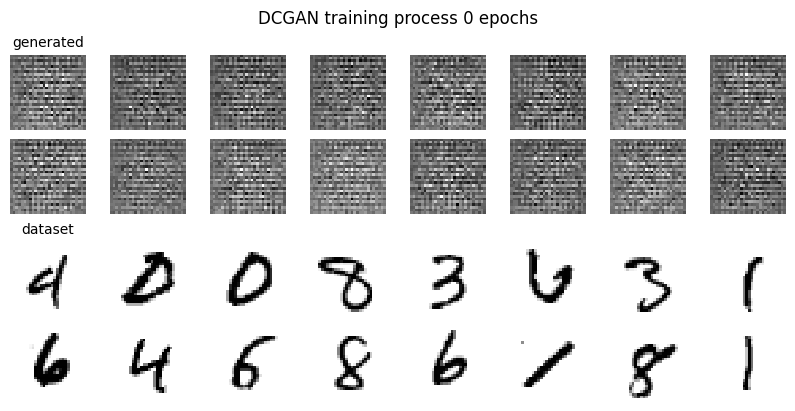

In [6]:
def mkdir_p(path):
    try:
        os.makedirs(path)
    except OSError:
        print('Folder already exists')

def plot_and_save_images(generated_images, folder_name, title, cols, rows, figsize, show=False, subtitles=False):
    fig, axs = plt.subplots(rows, cols, constrained_layout=True)
    fig.set_figheight(figsize[0])
    fig.set_figwidth(figsize[1])
    for i in range(rows):
        for j in range(cols):
            axs[i][j].imshow(generated_images[i][j], interpolation='nearest', cmap='gray_r')
            axs[i][j].axis('off')
            if not subtitles is None:
                if i == 0 and j == 0:
                    axs[i][j].set_title(subtitles[0], fontsize=10)
                if i == int(rows/2) and j == 0:
                    axs[i][j].set_title(subtitles[1], fontsize=10)
    
    fig.suptitle(title, fontsize=12)
    plt.savefig(os.path.join(folder_name, title + '.png'))
    if show:
        plt.show()
    plt.close()


def plot_generated_images(noise, folder_name, title, cols=8, rows=4, figsize=(4, 8), show=False, subtitles=('generated', 'dataset')):
    generated_images = generator.predict(noise)
    images = np.concatenate([generated_images, PICS_FROM_DATASET[0]])
    images = images.reshape(rows, cols, 28, 28)
    plot_and_save_images(images, folder_name, title, cols, rows, figsize, show, subtitles)
    

folder_name = 'GAN_pics_for_gif'
mkdir_p(os.path.join(folder_name))

title = f"DCGAN training process {0} epochs"
plot_generated_images(FIXED_NOISE, folder_name, title, show=True)

In [7]:
def optimizer():
    return tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5)

In [8]:
def make_discriminator():
    complexity = 70
    drop_rate = 0.2
    alpha = 0.2
    
    inp = Input(shape=(28, 28, 1))
    X = inp
    # 1 шар
    X = Conv2D(int(complexity/4),
               kernel_size=(5, 5),
               strides=(2, 2),
               kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02),
               padding='same')(X)
    X = LeakyReLU(alpha)(X)
    X = Dropout(drop_rate)(X)
    
    # 2 шар
    X = Conv2D(int(complexity/2),
               kernel_size=(5, 5),
               strides=(2, 2),
               #kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02),
               padding='same')(X)
    X = LeakyReLU(alpha)(X)
    X = Dropout(drop_rate)(X)
    
    # 3 шар
    X = Conv2D(int(complexity),
               kernel_size=(5, 5),
               strides=(2, 2),
               #kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02),
               padding='same')(X)
    X = LeakyReLU(alpha)(X)
    X = Dropout(drop_rate)(X)
    
    # 4 шар
    X = Conv2D(int(2*complexity),
               kernel_size=(5, 5),
               strides=(1, 1),
               #kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02),
            padding='same')(X)
    X = LeakyReLU(alpha)(X)
    X = Dropout(drop_rate)(X)
    
    # 5 шар
    X = Conv2D(int(complexity),
               kernel_size=(5, 5),
               strides=(1, 1),
               #kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02),
               padding='same')(X)
    X = LeakyReLU(alpha)(X)
    X = Dropout(drop_rate)(X)

    # 6 шар
    X = Flatten()(X)
    X_real_fake = Dense(1, activation='sigmoid', name='real_fake')(X)
    X_labels = Dense(DEPTH, activation='softmax', name='labels')(X)
    
    model = Model(inputs=inp, outputs=[X_real_fake, X_labels], name='discriminator')
    model.compile(loss={'real_fake': 'binary_crossentropy',
                        'labels': 'categorical_crossentropy'},
                  loss_weights={'real_fake':1,
                                'labels': 1},
                  optimizer=optimizer(),
                  metrics={'real_fake':'acc'})
    
    model.summary()
    return model
discriminator = make_discriminator()

Model: "discriminator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 28, 28, 1)]  0           []                               
                                                                                                  
 conv2d (Conv2D)                (None, 14, 14, 17)   442         ['input_3[0][0]']                
                                                                                                  
 leaky_re_lu_5 (LeakyReLU)      (None, 14, 14, 17)   0           ['conv2d[0][0]']                 
                                                                                                  
 dropout (Dropout)              (None, 14, 14, 17)   0           ['leaky_re_lu_5[0][0]']          
                                                                                      

In [9]:
discriminator.predict(generator.predict(FIXED_NOISE))

1/1 [==============================] - 0s 101ms/step


[array([[0.49979606],
        [0.4997964 ],
        [0.49979383],
        [0.49979585],
        [0.4998011 ],
        [0.49979556],
        [0.49979568],
        [0.4997937 ],
        [0.49979687],
        [0.49979386],
        [0.49979562],
        [0.49979335],
        [0.4997969 ],
        [0.49979386],
        [0.4997964 ],
        [0.4997953 ]], dtype=float32),
 array([[0.10004207, 0.10018034, 0.10027751, 0.09993543, 0.10005567,
         0.10007507, 0.09970956, 0.10010684, 0.09979317, 0.09982435],
        [0.10004175, 0.1001825 , 0.10027874, 0.09993389, 0.10005638,
         0.10007505, 0.09970776, 0.10010681, 0.09979381, 0.0998234 ],
        [0.10004297, 0.10018244, 0.10027876, 0.09993573, 0.10005651,
         0.10007653, 0.09970681, 0.10010546, 0.09979226, 0.09982258],
        [0.10004137, 0.10018187, 0.10027804, 0.09993459, 0.10005643,
         0.10007594, 0.09970802, 0.10010763, 0.09979337, 0.09982273],
        [0.10004229, 0.10018212, 0.10027795, 0.09993319, 0.10005749,
      

In [10]:
def make_gan(discriminator, generator):   
    noise = generator.inputs
    image = generator(noise)
    real_vs_fake_and_label = discriminator(image)
    gan = Model(inputs=noise, outputs=real_vs_fake_and_label)
    discriminator.trainable = False  
    gan.compile(loss={'discriminator':'binary_crossentropy',
                      'discriminator_1':'categorical_crossentropy'},
                
                optimizer=optimizer(),
                metrics={'discriminator':'acc'})
    discriminator.trainable = True
    gan.summary()
    return gan
gan = make_gan(discriminator, generator)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 10)]         0           []                               
                                                                                                  
 generator (Functional)         (None, 28, 28, 1)    789001      ['input_1[0][0]',                
                                                                  'input_2[0][0]']                
                                                                                                  
 discriminator (Functional)     [(None, 1),          579213      ['generator[0][0]']          

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 70ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 71ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 72ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 71ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 72ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 70ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


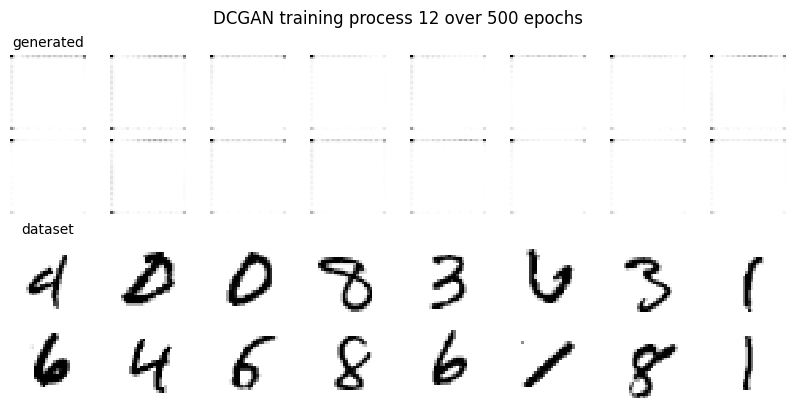

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5141276041666667


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 72ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 72ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 72ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 78ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


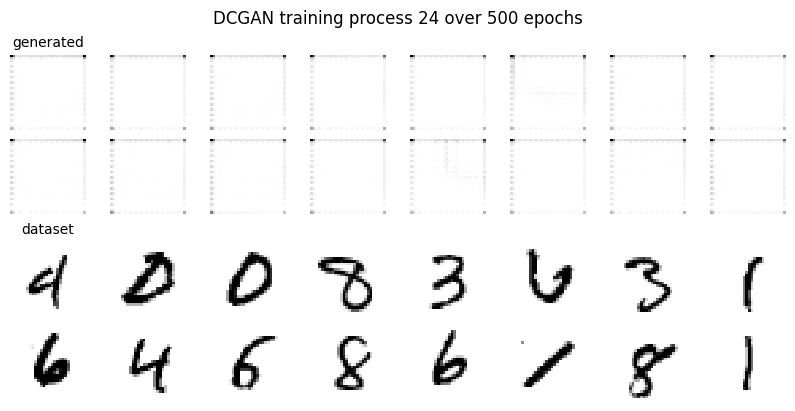

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5151529947916667


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 77ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 82ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 75ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 75ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 75ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


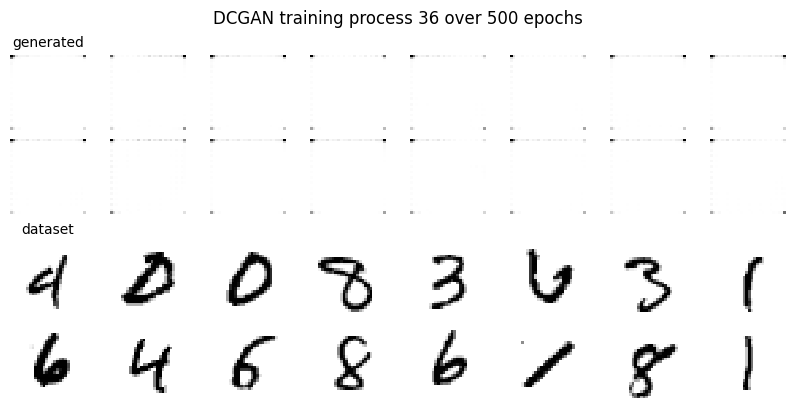

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5139485677083333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 75ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 77ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 86ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 73ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 75ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 76ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 77ms/step


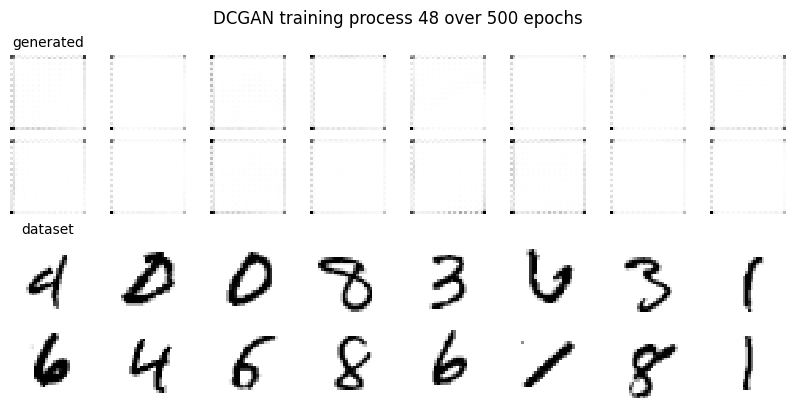

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5071126302083333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 77ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 79ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 79ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 79ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 78ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 78ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 79ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 77ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 77ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 89ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


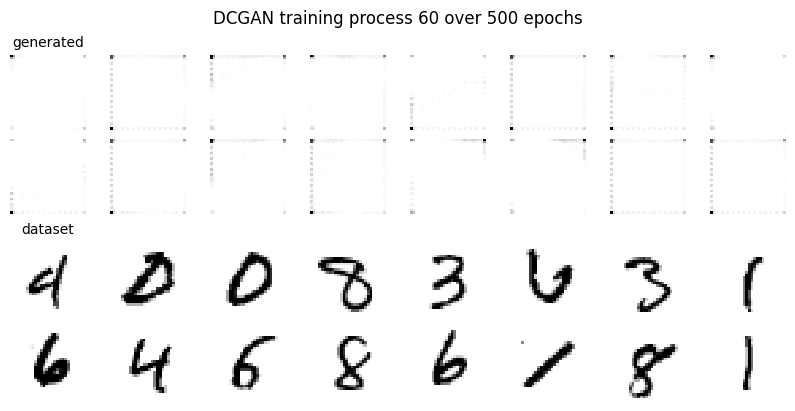

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5129231770833333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 83ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 78ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 83ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 83ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


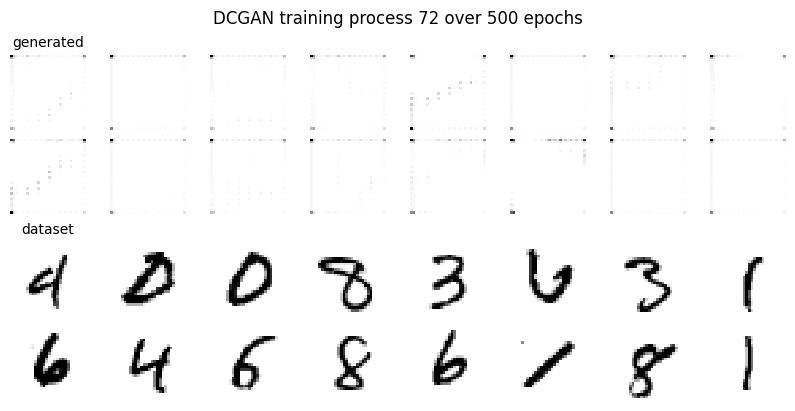

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5116048177083333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 82ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 82ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 82ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 82ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 83ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 83ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 82ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 84ms/step


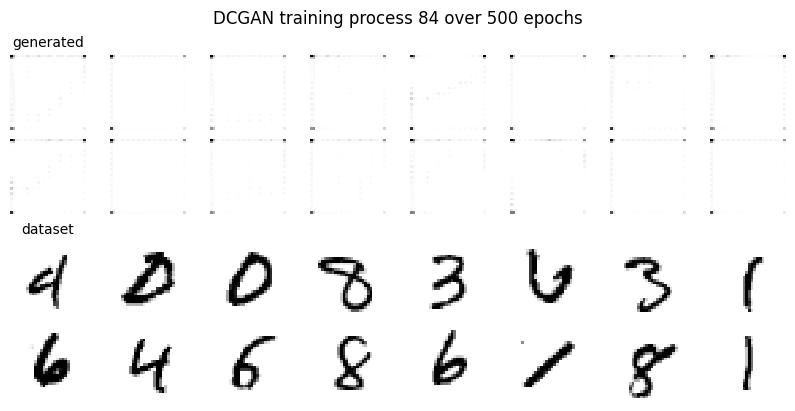

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5073893229166667


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 84ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 82ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 83ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 133ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 85ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 83ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 84ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 84ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 85ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 85ms/step


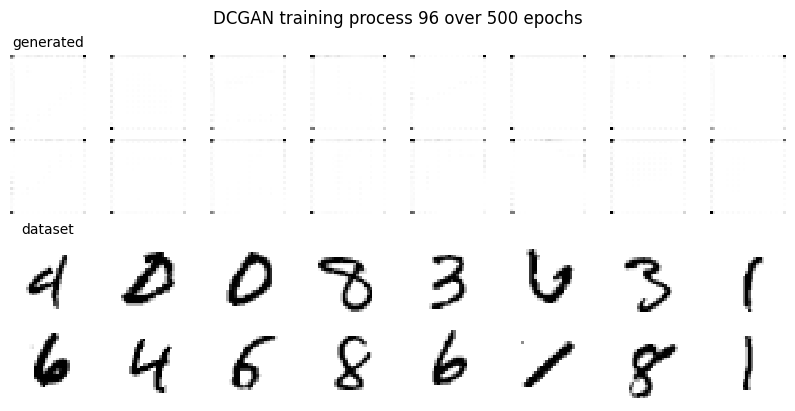

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5012532552083333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 86ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 87ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 84ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 85ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 86ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 86ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 88ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 87ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 86ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 86ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 87ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 86ms/step


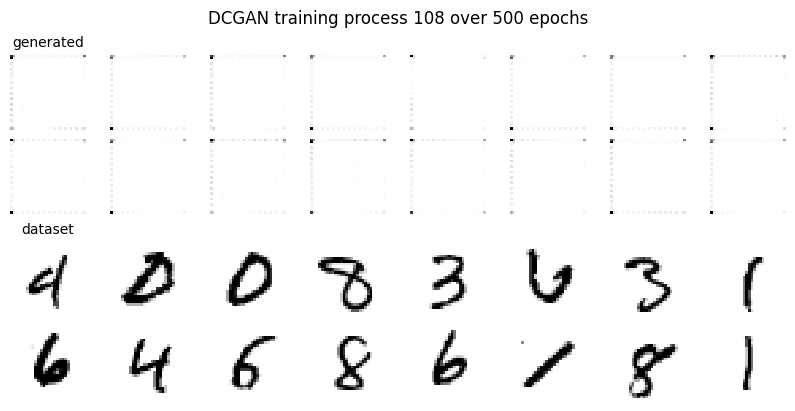

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.50458984375


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 85ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 89ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 88ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 89ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 89ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 87ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 89ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 87ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


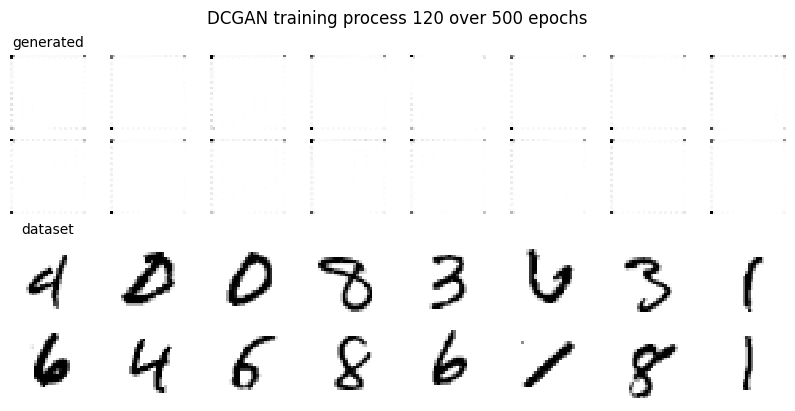

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5044921875


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 90ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 90ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 92ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 93ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 93ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 92ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 91ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 92ms/step


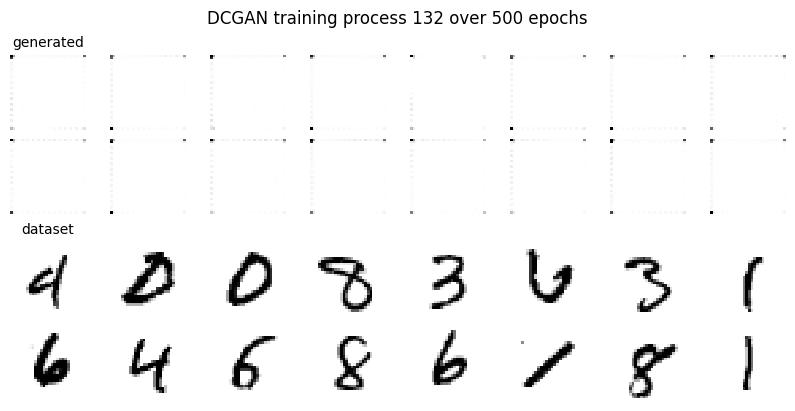

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.502490234375


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 94ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 115ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 93ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 92ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 92ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 96ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 92ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 94ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 93ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


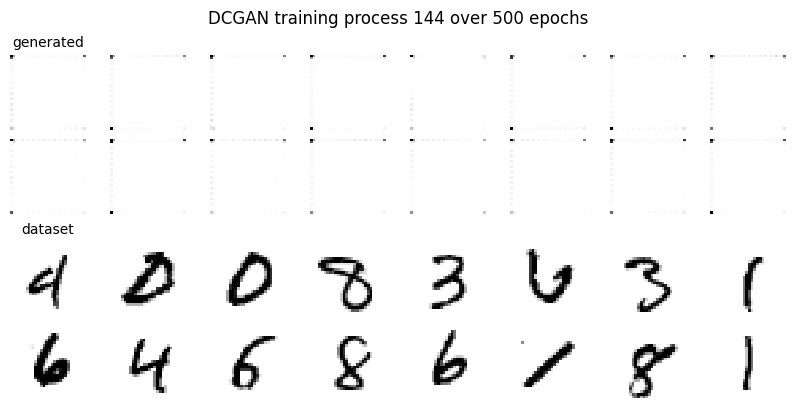

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5004231770833333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 96ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 96ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 97ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 94ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 96ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 94ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 93ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 100ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 94ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


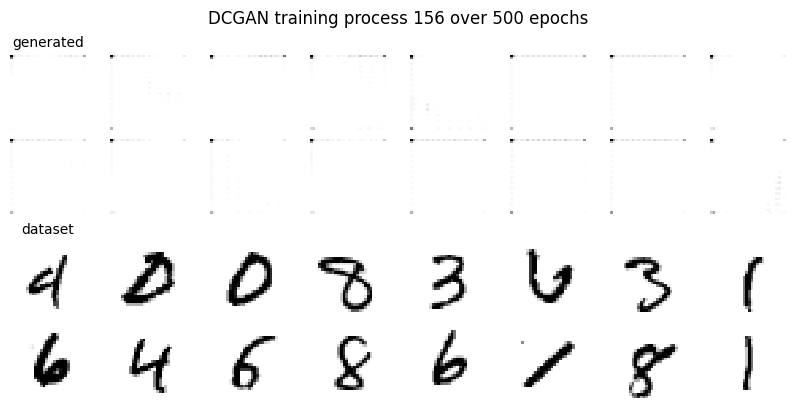

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.498876953125


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 99ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 96ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 98ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 94ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 98ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 95ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 99ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 98ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 98ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 98ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 98ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 99ms/step


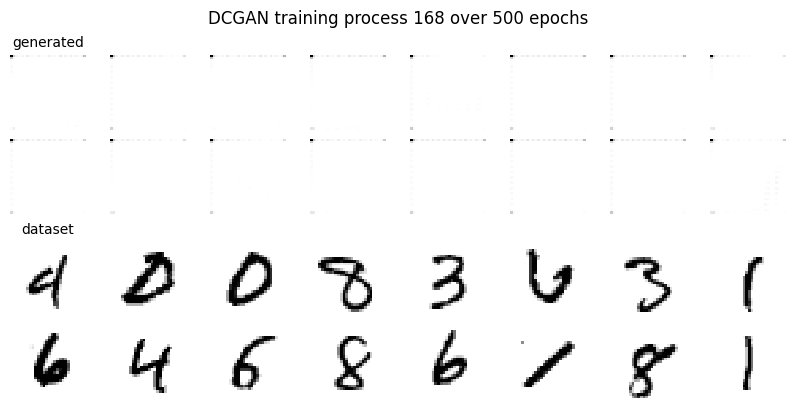

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5043294270833333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 101ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 100ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 101ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 99ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 108ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 98ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 101ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 100ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 101ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 101ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 100ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 102ms/step


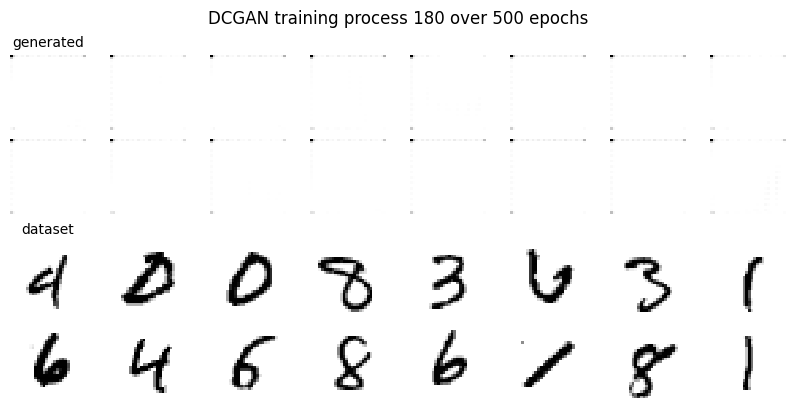

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5031087239583333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 102ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 102ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 102ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 105ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 99ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 107ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 139ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 105ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 115ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 100ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 102ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 108ms/step


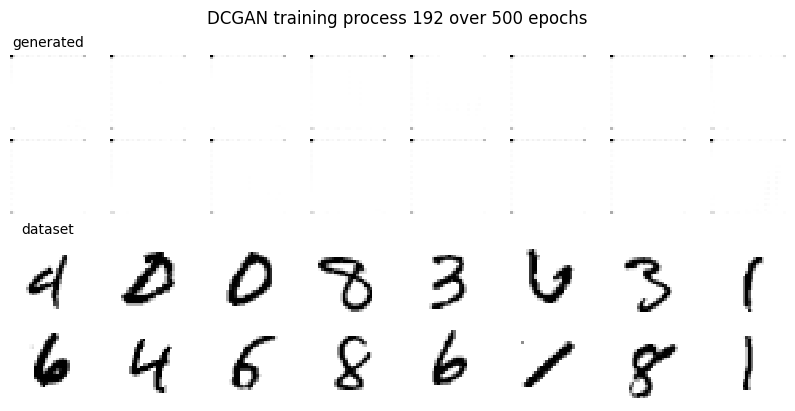

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5029296875


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 112ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 103ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 104ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 107ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 105ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 132ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 106ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 111ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 113ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 134ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 118ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 111ms/step


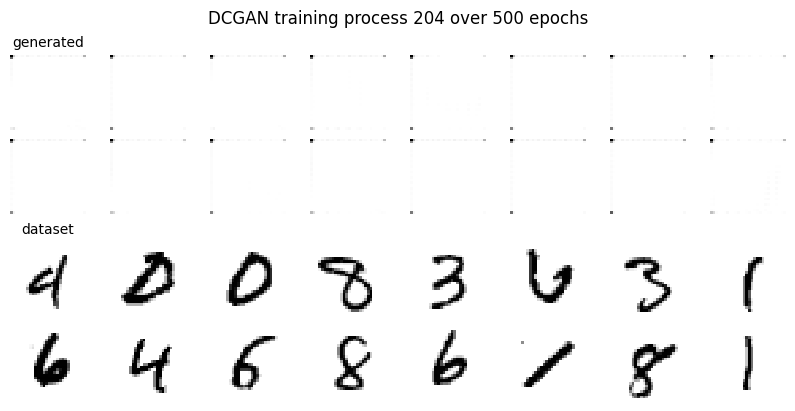

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.50009765625


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 153ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 108ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 110ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 107ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 119ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 111ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 113ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 114ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 116ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 115ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 128ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 119ms/step


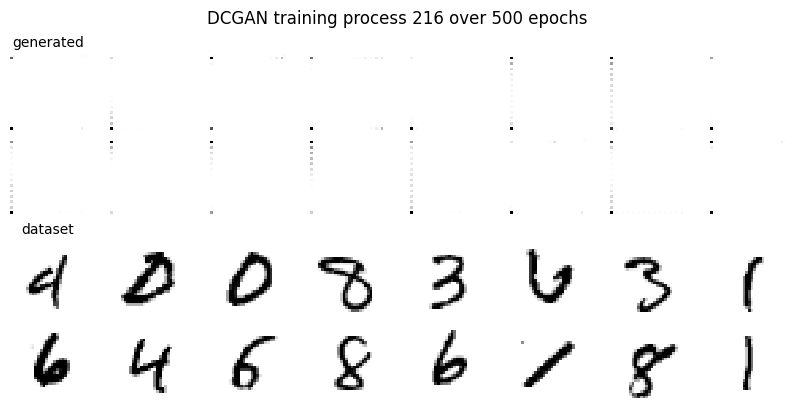

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5009765625


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 109ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 112ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 112ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 111ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 111ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 112ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 110ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 112ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 111ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 114ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 115ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 113ms/step


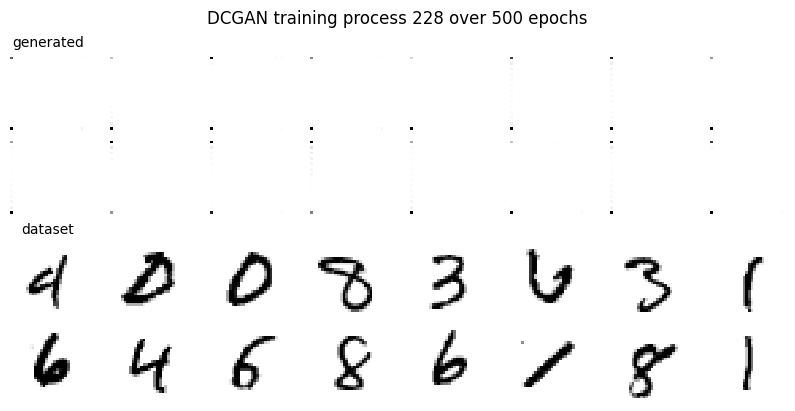

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.50087890625


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 123ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 152ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 125ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 161ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 115ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 115ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 115ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 121ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 117ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 117ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 114ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 114ms/step


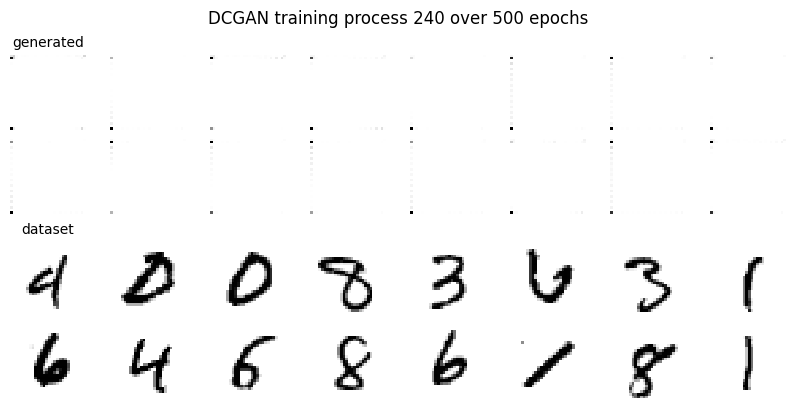

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.500830078125


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 114ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 117ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 117ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 121ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 120ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 117ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 119ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 116ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 117ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 117ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 124ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 121ms/step


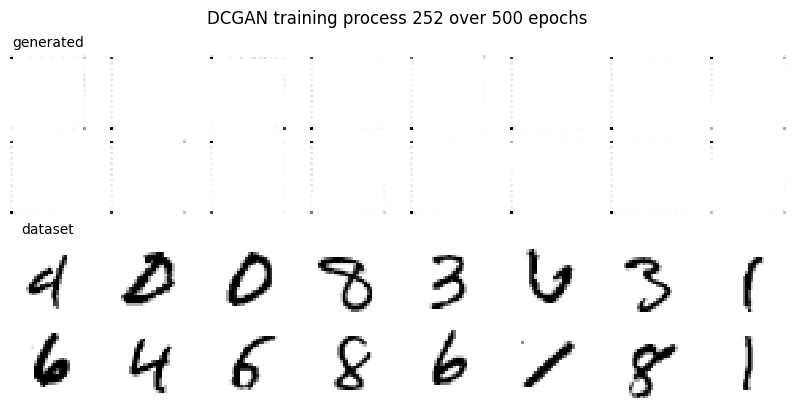

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.502587890625


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 113ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 120ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 121ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 121ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 123ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 123ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 122ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 120ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 124ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 128ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 121ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 128ms/step


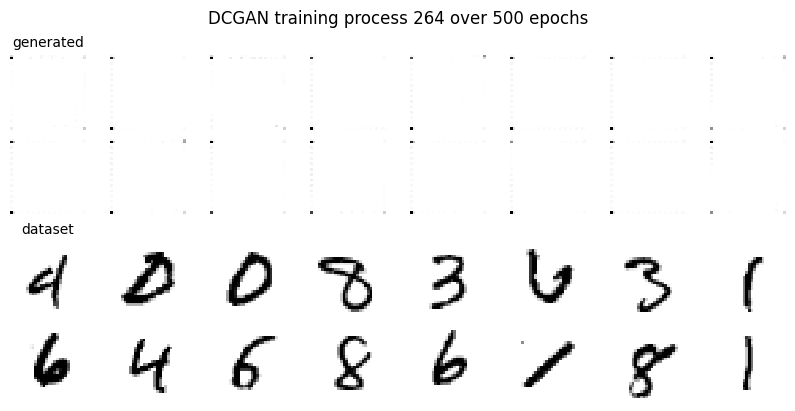

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5045735677083333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 127ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 128ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 124ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 124ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 126ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 130ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 121ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 125ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 122ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 132ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 126ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 125ms/step


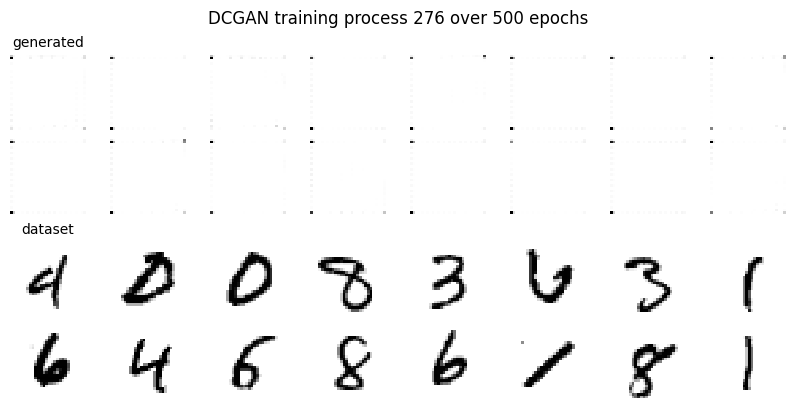

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.504541015625


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 133ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 130ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 127ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 130ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 124ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 125ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 128ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 134ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 136ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 131ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 137ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 129ms/step


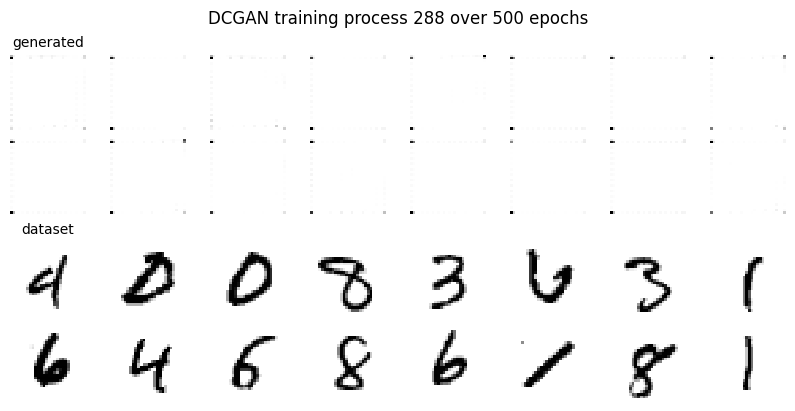

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5037109375


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 130ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 128ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 133ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 141ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 137ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 135ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 136ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 136ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 134ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 133ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 142ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 142ms/step


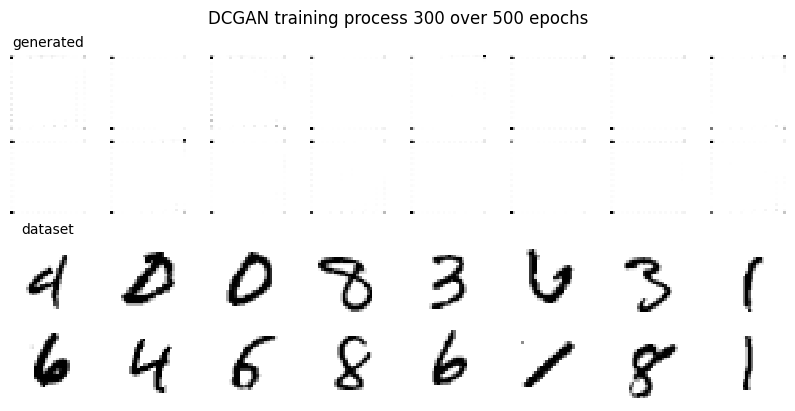

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5033203125


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 137ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 140ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 136ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 136ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 144ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 141ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 137ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 137ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 140ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 136ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 137ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 142ms/step


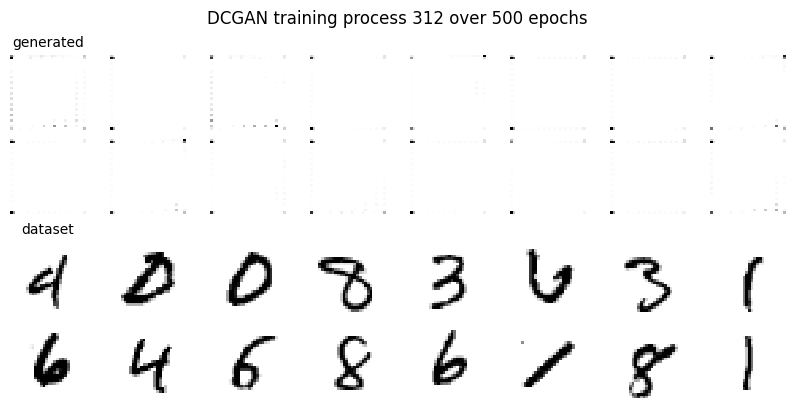

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5032063802083333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 139ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 136ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 143ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 142ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 141ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 144ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 137ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 146ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 145ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 139ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 144ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 149ms/step


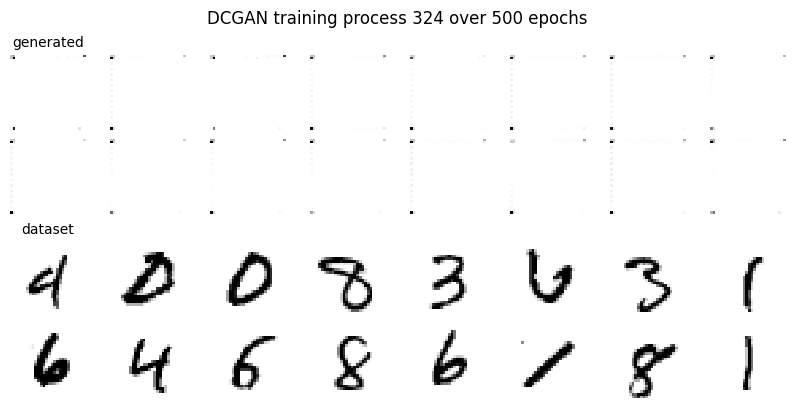

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5032877604166667


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 146ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 148ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 143ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 145ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 168ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 149ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 158ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 163ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 159ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 152ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 154ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 167ms/step


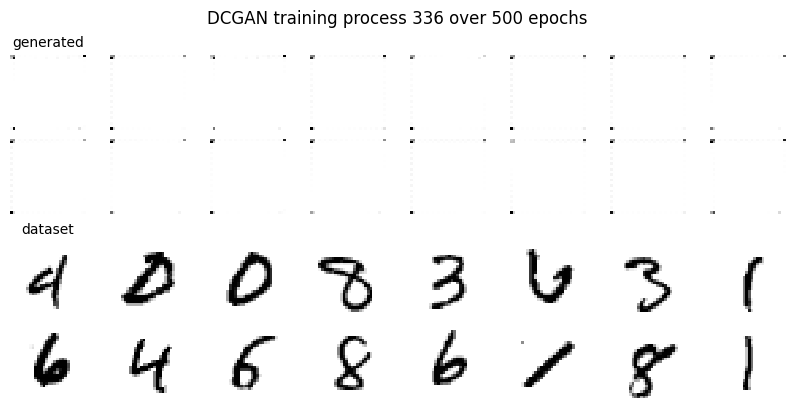

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5027180989583333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 170ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 152ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 158ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 190ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 172ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 172ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 165ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 162ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 148ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 164ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 165ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 175ms/step


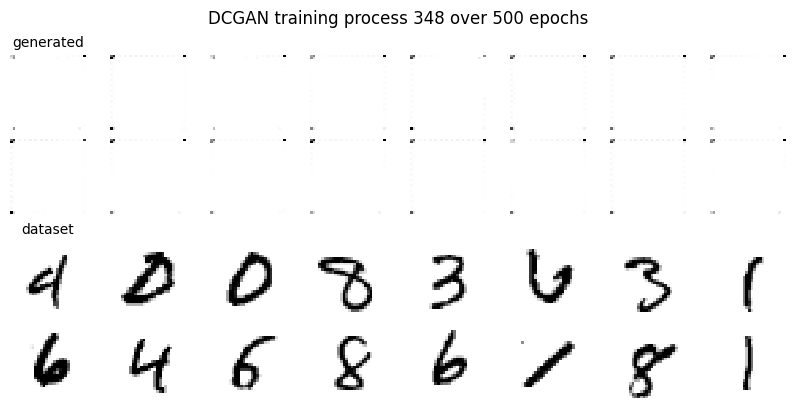

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5015462239583334


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 172ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 167ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 170ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 181ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 167ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 157ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 164ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 159ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 161ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 158ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 164ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 168ms/step


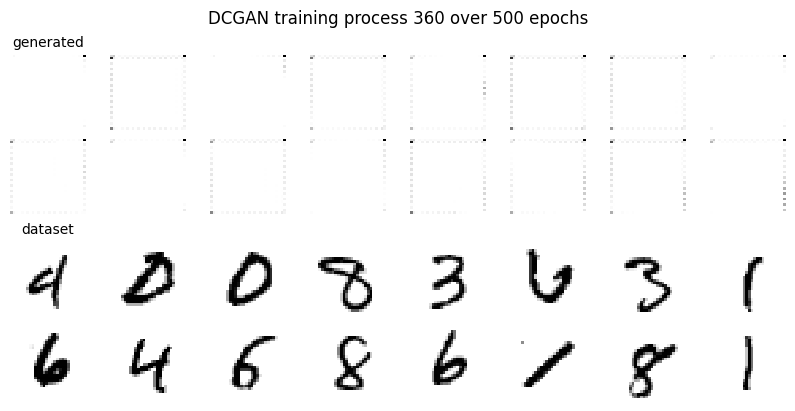

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5020345052083334


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 171ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 171ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 180ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 173ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 181ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 173ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 171ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 173ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 171ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 160ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 167ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 170ms/step


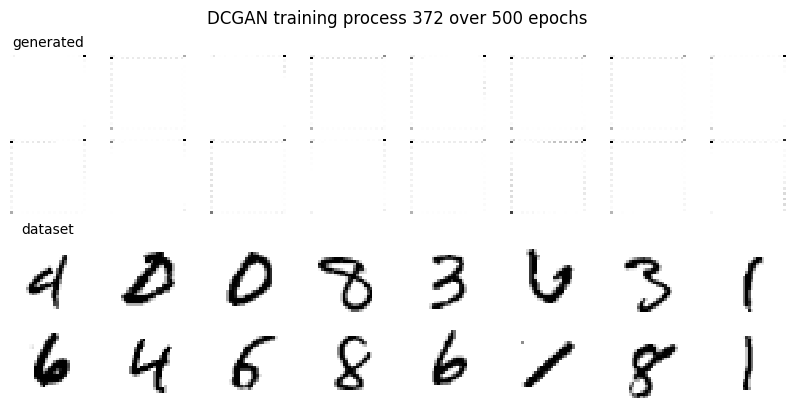

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.50283203125


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 172ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 167ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 178ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 164ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 163ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 164ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 158ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 166ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 160ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 159ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 170ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 167ms/step


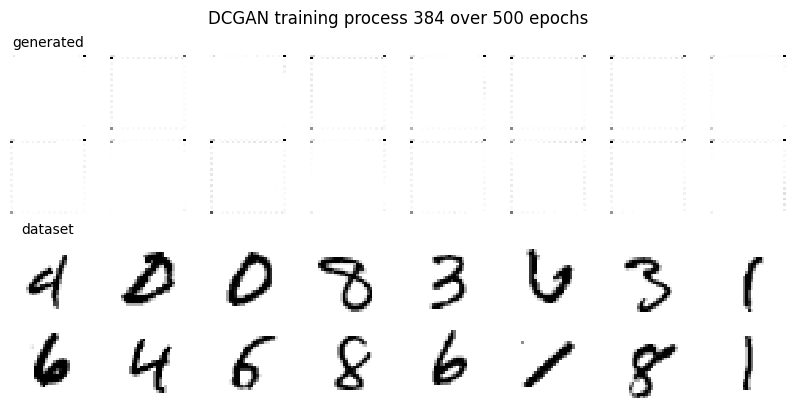

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5024576822916667


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 169ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 178ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 170ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 179ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 168ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 174ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 175ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 183ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 188ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 179ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 182ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 183ms/step


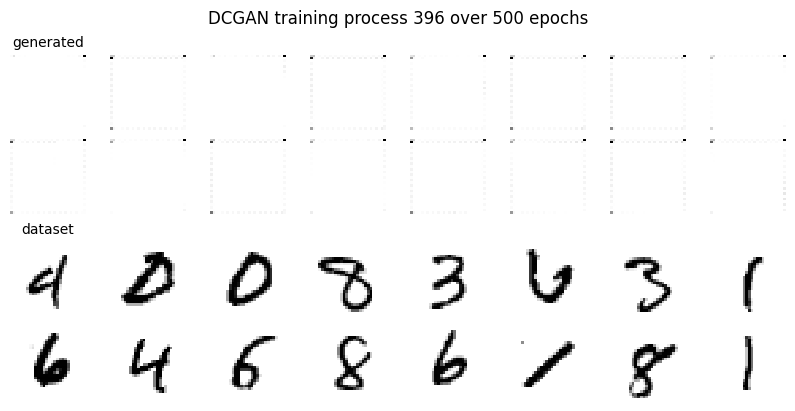

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5014973958333333


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 181ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 181ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 190ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 183ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 171ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 172ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 169ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 179ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 175ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 168ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 196ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 173ms/step


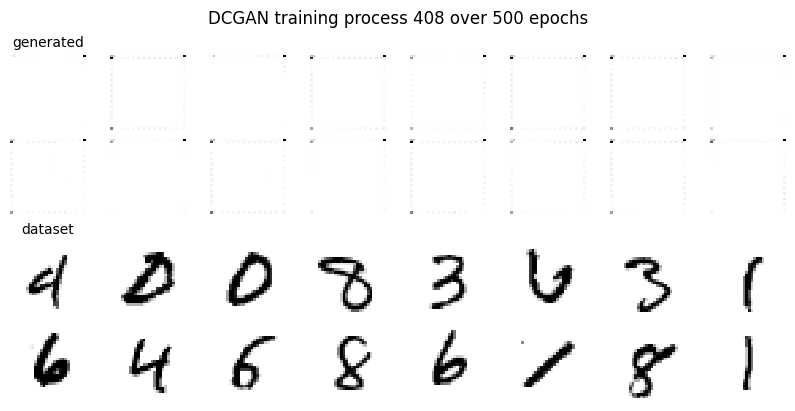

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.5012858072916667


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 179ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 179ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 196ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 181ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 186ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 176ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 179ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 189ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 195ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 178ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 188ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 189ms/step


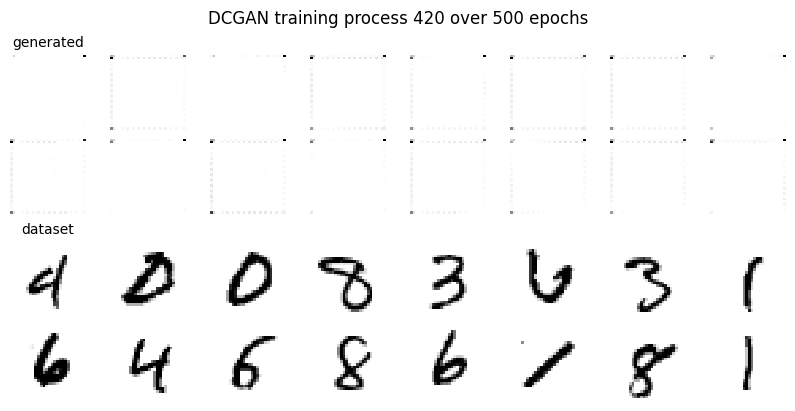

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.4998697916666667


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 201ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 186ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 186ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 209ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 173ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 199ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 197ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 197ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 187ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 196ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 188ms/step


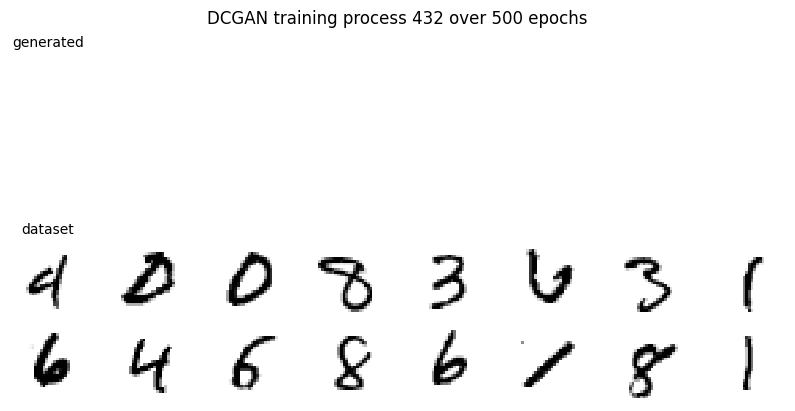

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.106201171875


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 203ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 191ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 194ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 189ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 190ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 184ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 203ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 191ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 191ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 194ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 199ms/step


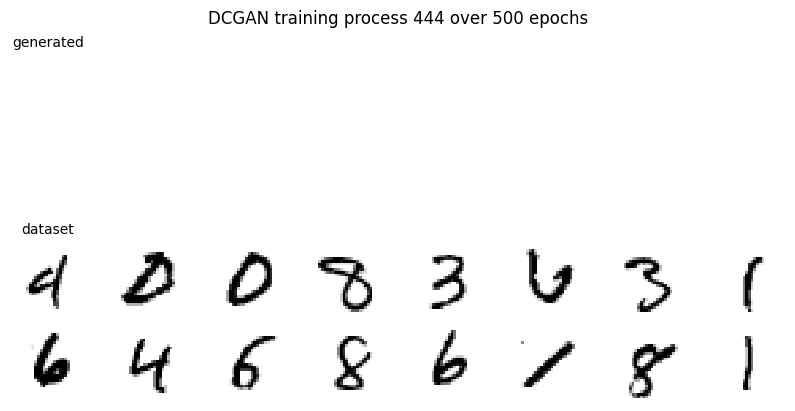

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.0


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 200ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 190ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 194ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 198ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 198ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 194ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 204ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 206ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 201ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 205ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 207ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


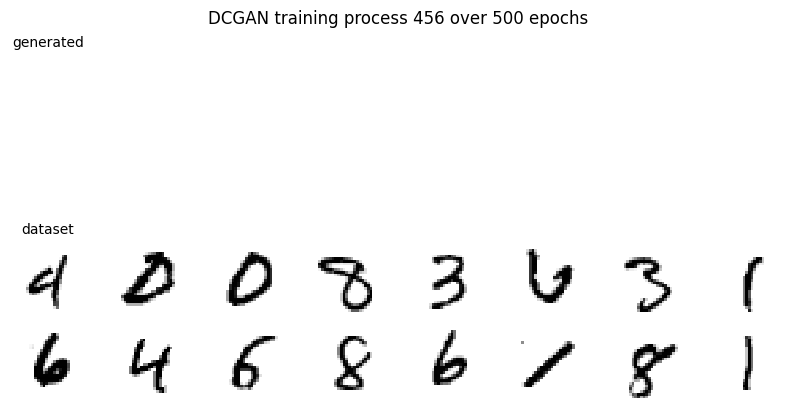

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.0


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 204ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 204ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 222ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 211ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 235ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 199ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 207ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 202ms/step


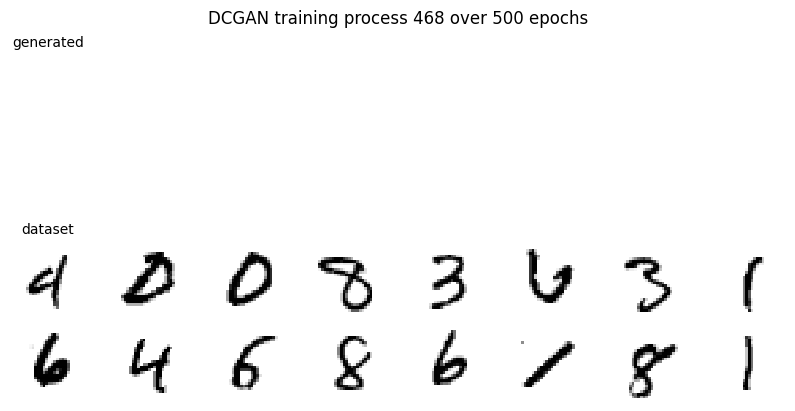

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.0


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 213ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 214ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 206ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 197ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 210ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 206ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 225ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 221ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 215ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 201ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 215ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 222ms/step


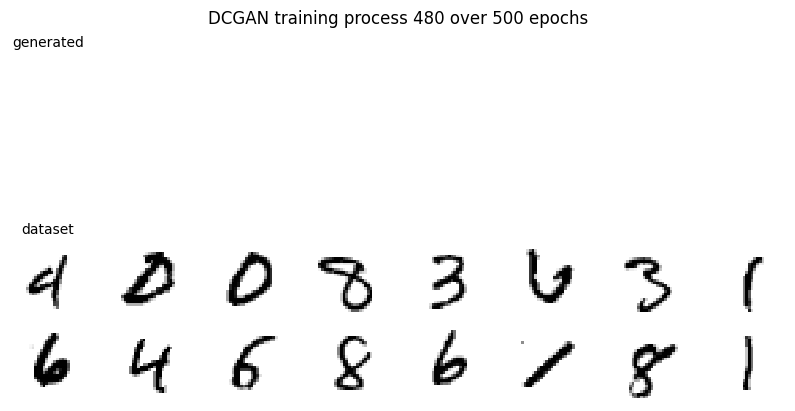

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.0


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 226ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 217ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 223ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 213ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 211ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 206ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 208ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 212ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 229ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 216ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 226ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 211ms/step


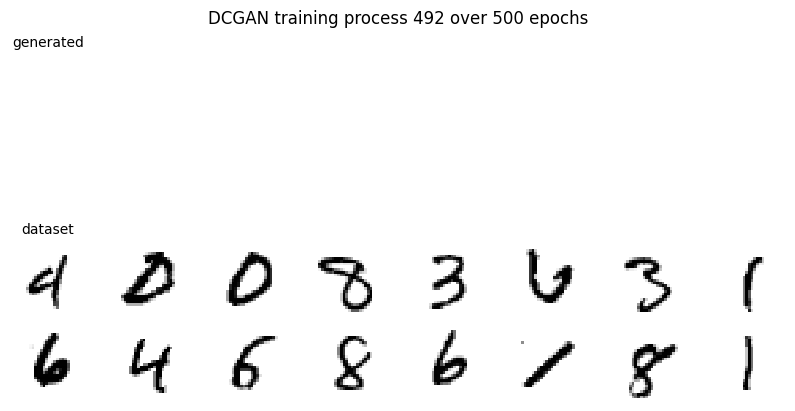

Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:
0.0


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 220ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 212ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 215ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 214ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 235ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 210ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 236ms/step


  0%|          | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 236ms/step
CPU times: total: 1d 14h 56min 10s
Wall time: 14h 42min 17s


In [11]:
%%time
EPOCHS = 500
BATCH_SIZE = 128
data = DataGenerator(train_images, train_labels, batches_per_epoch=40, batch_size=BATCH_SIZE)
# масив для відслідковування стабільності навчання
generator_acc_follow = []
for epoch in tqdm(range(1, EPOCHS+1)):
    for images_batch, labels_batch in data:
        # Навчання дискримінатора
        noise = data.rand_batch()
        generated_images = generator.predict(noise)
        X = np.concatenate([images_batch, generated_images])
        # Згладжування цільових значень
        y_real = np.random.uniform(0.8, 1, size=[BATCH_SIZE])
        y_fake = np.random.uniform(0, 0.2, size=[BATCH_SIZE])
        y_real_fake = np.concatenate([y_real, y_fake])
        # Цільові значення міток
        y_labels = np.concatenate([labels_batch, np.zeros((BATCH_SIZE, DEPTH))])
        # навчаємо дискрімінатор
        discriminator.train_on_batch(X, [y_real_fake, y_labels])
        
        # Навчання генератора
        noise = data.rand_batch()
        # Вказуємо цільові значення
        y_real_fake = np.ones(BATCH_SIZE)
        # Навчаємо GAN і зберігаємо точність у масив
        generator_acc_follow.append(gan.train_on_batch(noise, [y_real_fake, noise[1]])[-1])

    # Будуємо зображення і зберігаємо його для створення .gif
    title = f"DCGAN training process {epoch} over {EPOCHS} epochs"
    if epoch%int(EPOCHS/40)==0:
        plot_generated_images(FIXED_NOISE, folder_name, title, show=True)
        print('Якщо генератор і дескрімінатор сбалансовані, точність генератора прямує в 0 або 1:')
        print(np.mean(generator_acc_follow))
        generator_acc_follow = []
    else:
        plot_generated_images(FIXED_NOISE, folder_name, title)
        
generator.save('generator_trained.h5')

  0%|          | 0/501 [00:00<?, ?it/s]

C:\Users\Gamalya\AppData\Local\Temp\ipykernel_11460\1148729360.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(os.path.join(folder_name, filename))


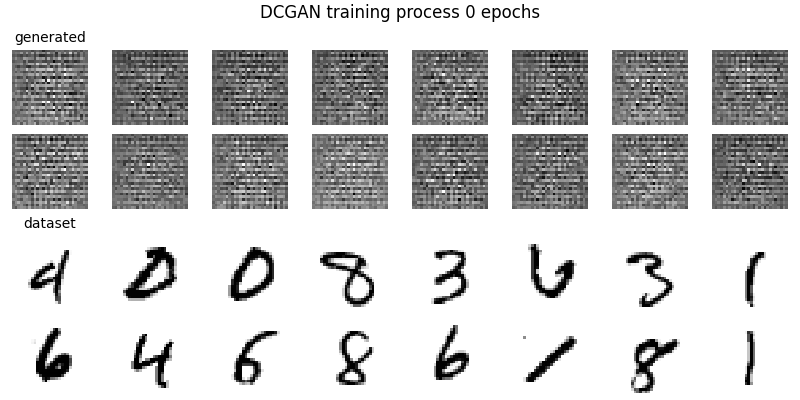

In [12]:
for folder_data in os.walk(os.path.join(folder_name)):
    all_pics_filenames = sorted(folder_data[2], key=lambda x: int(x.split()[3]))

with imageio.get_writer('DCGAN training.gif', mode='I', fps=60) as writer:
    for filename in tqdm(all_pics_filenames):
        image = imageio.imread(os.path.join(folder_name, filename))
        writer.append_data(image)
        
with open('DCGAN training.gif','rb') as f:
    display(Image(data=f.read(), format='png'))

### Так мало бути

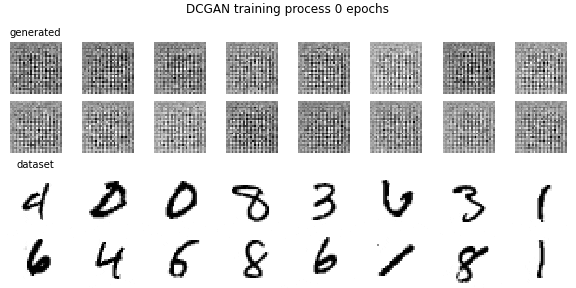